In [1]:
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

from sklearn import metrics
from sklearn import model_selection
import lightgbm as lgb
import ethik

from sklearn.decomposition import PCA
import plotly.express as px

from bioinfokit.visuz import cluster
from IPython.display import Image

pd.set_option("display.max.columns", None)
pd.set_option("display.precision", 2)

In [2]:
from dataprep.eda import plot;

In [3]:
df = pd.read_csv("data/adult1.csv", index_col=0)
df.head()

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income_label
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,0
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,0
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,0
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,0
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,0


  0%|          | 0/606 [00:00<?, ?it/s]


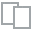
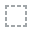
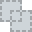
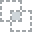
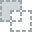
...
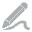
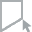
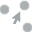
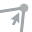
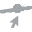

In [4]:
plot(df)

In [4]:
df1 = df.drop_duplicates(keep=False)
df1 = df1.dropna()

  0%|          | 0/606 [00:00<?, ?it/s]


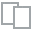
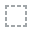
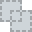
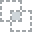
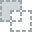
...
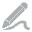
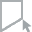
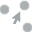
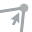
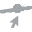

In [6]:
plot(df1)

In [7]:
df1.describe(include=object)

,workclass,education,marital_status,occupation,relationship,race,sex,native_country
count,30117,30117,30117,30117,30117,30117,30117,30117
unique,7,16,7,14,6,5,2,41
top,Private,HS-grad,Married-civ-spouse,Prof-specialty,Husband,White,Male,United-States
freq,22243,9828,14053,4030,12451,25892,20352,27470


In [8]:
df1.describe()

,age,fnlwgt,education_num,capital_gain,capital_loss,hours_per_week,income_label
count,30117.00,3.01e+04,30117.00,30117.00,30117.00,30117.00,30117.00
mean,38.45,1.90e+05,10.12,1093.64,88.50,40.94,0.25
std,13.13,1.06e+05,2.55,7411.76,404.59,11.98,0.43
min,17.00,1.38e+04,1.00,0.00,0.00,1.00,0.00
25%,28.00,1.18e+05,9.00,0.00,0.00,40.00,0.00
50%,37.00,1.78e+05,10.00,0.00,0.00,40.00,0.00
75%,47.00,2.37e+05,13.00,0.00,0.00,45.00,0.00
max,90.00,1.48e+06,16.00,99999.00,4356.00,99.00,1.00


In [23]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 32514 entries, 0 to 32560
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             32514 non-null  int64 
 1   workclass       30678 non-null  object
 2   fnlwgt          32514 non-null  int64 
 3   education       32514 non-null  object
 4   education_num   32514 non-null  int64 
 5   marital_status  32514 non-null  object
 6   occupation      30671 non-null  object
 7   relationship    32514 non-null  object
 8   race            32514 non-null  object
 9   sex             32514 non-null  object
 10  capital_gain    32514 non-null  int64 
 11  capital_loss    32514 non-null  int64 
 12  hours_per_week  32514 non-null  int64 
 13  native_country  31933 non-null  object
 14  income_label    32514 non-null  int64 
dtypes: int64(7), object(8)
memory usage: 4.0+ MB


In [5]:
categorical_columns = ['workclass', 'education', 'marital_status', 'relationship',
                      'race', 'sex', 'native_country', 'occupation']

numerical_columns = ['age', 'fnlwgt', 'education_num', 'capital_gain', 
                     'capital_loss', 'hours_per_week', 'income_label']

In [6]:
for category in categorical_columns:
    df1[category] = df1[category].astype('category')
    
df1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30117 entries, 0 to 32560
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   age             30117 non-null  int64   
 1   workclass       30117 non-null  category
 2   fnlwgt          30117 non-null  int64   
 3   education       30117 non-null  category
 4   education_num   30117 non-null  int64   
 5   marital_status  30117 non-null  category
 6   occupation      30117 non-null  category
 7   relationship    30117 non-null  category
 8   race            30117 non-null  category
 9   sex             30117 non-null  category
 10  capital_gain    30117 non-null  int64   
 11  capital_loss    30117 non-null  int64   
 12  hours_per_week  30117 non-null  int64   
 13  native_country  30117 non-null  category
 14  income_label    30117 non-null  int64   
dtypes: category(8), int64(7)
memory usage: 2.1 MB


##### source: https://xai-aniti.github.io/ethik/tutorials/binary-classification.html

In [7]:
df1['sex'] = df1['sex'].str.strip().astype('category')  # Remove leading whitespace
y = df1.pop('income_label')

df1.head()

,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba


ethik analyzes a model based on the predictions it makes on a test set. Consequently, we first have to split our dataset in two.

In [8]:
X_train, X_test, y_train, y_test = model_selection.train_test_split(df1, y, shuffle=True, random_state=42)


We will now train a classifier using [LightGBM.](https://lightgbm.readthedocs.io/en/latest/)

In [9]:
model = lgb.LGBMClassifier(random_state=42).fit(X_train, y_train)

We can now make predictions for the test set. We'll use a variable named y_pred to store the predicted probabilities associated with the True label.

In [20]:
y_pred = model.predict_proba(X_test)[:, 1]

# We use a named pandas series to make plot labels more explicit
y_pred1 = pd.Series(y_pred, name='pred')
y_test1 = pd.Series(y_test, name='test')

y_pred1 = y_pred1.set_axis(y_test1.index)

In [24]:
df_pred = pd.concat([y_pred1,y_test1], axis=1)

df_pred['pred'] = [1 if n>0.5 else 0 for n in df_pred['pred']]
df_pred.head(5)

,pred,test
24158,0,0
6644,0,0
27226,1,1
19407,0,0
18980,1,1


In [16]:
y_test1.head()

24158    0
6644     0
27226    1
19407    0
18980    1
Name: 1, dtype: int64

In [17]:
y_pred1.head()

0    1.89e-03
1    1.09e-01
2    9.94e-01
3    4.19e-03
4    7.87e-01
Name: 1, dtype: float64

We can now fit an Explainer using the features from the test set. This will analyze the distribution of each feature and build a set of lambda coefficients which can be used to explain model predictions.

In [33]:
explainer = ethik.ClassificationExplainer()

### Understanding model predictions

In [34]:
explainer.plot_influence(
    X_test=X_test['age'],
    y_pred=y_pred
).show()
explainer.plot_influence(
    X_test=X_test['education_num'],
    y_pred=y_pred
).show()


/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/cache_explainer.py:153: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

100%|██████████| 41/41 [00:00<00:00, 1309.66it/s]


/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/cache_explainer.py:153: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

100%|██████████| 41/41 [00:00<00:00, 1317.84it/s]


We can also plot the distribution of predictions for more than one variable. However, because different variables have different scales we have to use a common measure to display them together. For this purpose we plot the τ ("tau") values. These values are contained between -1 and 1 and simply reflect by how much the variable is shifted from it's mean towards it's lower and upper quantiles. In the following figure a tau value of -1 corresponds to just under 20 years old whereas a tau value of 1 refers to being slightly over 60 years old.

In [35]:
explainer.plot_influence(
    X_test=X_test[['age', 'hours_per_week', 'education_num']],
    y_pred=y_pred,
    colors={
        'age': 'red',
        'hours_per_week': 'green',
        'education_num': 'blue'
    }
)

/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/cache_explainer.py:153: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

100%|██████████| 123/123 [00:00<00:00, 1326.23it/s]


We can also get an overview of features' importance and determine which ones impact the predictions the most:

In [36]:
explainer.plot_influence_ranking(
    X_test=X_test[['age', 'fnlwgt', 'education_num', 'capital_gain', 
                     'capital_loss', 'hours_per_week']],
    y_pred=y_pred,
)

/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/query.py:142: ConstantWarning:

all the values of feature capital_loss are identical

/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/cache_explainer.py:153: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

100%|██████████| 226/226 [00:00<00:00, 1327.12it/s]


The importance is computed as the average absolute difference in bias changes per tau increase. If the curves plotted above are horizontal lines, we can conclude that the corresponding features do not impact the predictions at all. So, to compute the importance of a feature, we compute the distance to this horizontal line. In other words, the less the curve is flat, the more it is deemed important by the model.

### Evaluating model reliability

ethik can also be used to assess the reliability of a model with respect to a variable. Let us first evaluate the global performance of our model.

In [138]:
# As `y_test` is binary (0 or 1), we need to make `y_pred` binary as well
# for `metrics.accuracy_score` to work.
print(f'Accuracy score: {metrics.accuracy_score(y_test, y_pred > 0.5):.4f}')

Accuracy score: 0.8704


We can see how performant the model is with respect to a variable or multiple variables.

In [141]:
explainer.plot_performance(
    X_test=X_test[['age', 'education_num']],
    y_test=y_test,
    y_pred=y_pred > 0.5,
    metric=metrics.accuracy_score,
)

/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/cache_explainer.py:153: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

100%|██████████| 82/82 [00:00<00:00, 678.52it/s]


We can see that although the overall accuracy is around 0.88, it is much higher when the age is lower. This is quite intuitive, as we can imagine that young adults more often than not have a salary under $50k. When they get older, many things can happen and their salary isn't as easy to guess, which translates to a lower model accuracy.


These kind of reliability plots can be used for many cases. For example, now that we know the model is less accurate for older people than young ones, we might want to focus our data analysis on older people in order to extract helpful features. ethik can thus help guide a data science project by telling you where your model is failing to perform.

We can also rank features by their impact on performance. Here, we want to show how bad the model can be when we make each feature's mean change:


In [144]:
explainer.plot_performance_ranking(
    X_test=X_test[['age', 'education_num', 'hours_per_week', 'sex']],
    y_test=y_test,
    y_pred=y_pred > 0.5,
    metric=metrics.accuracy_score,
    criterion='min',  # We are looking at the worst accuracy
)



/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/cache_explainer.py:153: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

100%|██████████| 205/205 [00:00<00:00, 703.10it/s]


This plot tells us that whatever the mean age of the dataset is (among the ones we computed), the model's accuracy is at least 86%. We also notice that changing the mean of education-num can lead to worse performance than changing the mean age. In other words the above barplot displays potential accuracy scores in worst case scenarios.

To plot the n features for which the model reaches the lowest accuracy, we can use the parameter n_features:


In [146]:
explainer.plot_performance_ranking(
    X_test=X_test[['age', 'education_num', 'hours_per_week', 'sex']],
    y_test=y_test,
    y_pred=y_pred > 0.5,
    metric=metrics.accuracy_score,
    criterion='min',  # We are looking at the worst accuracy
    n_features=-2,  # We plot the two features with the smallest score in the ranking
)

/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/cache_explainer.py:153: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

100%|██████████| 205/205 [00:00<00:00, 655.53it/s]


##  Categorical features

Until now, we just manipulated numeric features. But ethik can also compute the influence of categorical features, that must have either the type object or category in the dataframe:

In [147]:
X_test['sex'].head()

24158      Male
6644       Male
27226      Male
19407    Female
18980      Male
Name: sex, dtype: category
Categories (2, object): ['Female', 'Male']

In [148]:
explainer.plot_influence(
    X_test=X_test['sex'],
    y_pred=y_pred,
)

/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/cache_explainer.py:153: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

100%|██████████| 82/82 [00:00<00:00, 1379.19it/s]


From the categorical feature gender, two numeric features are created: one per category, which represents the proportion of this category in the dataset (between 0 and 1). Since we only have two possible values for gender, the resulting numeric features are symmetric.

Not surprisingly, but sadly, we can see that according to the model, men have a higher chance of earning $50k a year. The model is simply reproducing the bias that is contained in the dataset. Let's still notice that this is a correlation and that causality has not been proven at this stage.

We can plot the performance as well:

In [149]:
explainer.plot_performance(
    X_test=X_test['sex'],
    y_test=y_test,
    y_pred=y_pred > 0.5,
    metric=metrics.accuracy_score,
)

/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/cache_explainer.py:153: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

100%|██████████| 82/82 [00:00<00:00, 695.30it/s]


To plot a single category, we use ethik.extract_category():

In [151]:
explainer.plot_influence(
    X_test=ethik.extract_category(X_test['sex'], 'Male'),
    y_pred=y_pred,
)

/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/cache_explainer.py:153: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

100%|██████████| 41/41 [00:00<00:00, 1281.31it/s]


## Robustnes

Right. We have observed both the model's bias and it's performance. How can we be sure that these estimates are reliable? One criterion to trust an algorithm is its robustness, i.e. the fact that it gives similar outputs for similar inputs.

To check the robustness in ethik, we can compute a confidence interval on the explanation:

    Get p% of the rows in the dataset
    Compute the explanation (i.e. the bias or the performance)
    Do that n times
    Have a look at the distribution of the explanations

Let's do it for n = 30 and p = 0.8 (the default):


In [152]:
explainer = ethik.ClassificationExplainer(n_samples=30)

Then we can explain and plot the bias simply as before. To compute the confidence interval, we consider the 5% and 95% quantiles:

In [153]:
explainer.plot_influence(
    X_test=X_test['education_num'],
    y_pred=y_pred,
)


/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/cache_explainer.py:153: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

100%|██████████| 1230/1230 [00:00<00:00, 1380.36it/s]


The plotted line is the mean. The confidence interval is so small that we need to zoom in to see it. This means that the algorithm is quite robust on this dataset (which only contains the education-num feature).

The algorithm is a little less robust to compute the performance:

In [155]:
explainer.plot_performance(
    X_test=X_test['education_num'],
    y_test=y_test,
    y_pred=y_pred > 0.5,
    metric=metrics.accuracy_score,
)

/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/cache_explainer.py:153: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

100%|██████████| 1230/1230 [00:01<00:00, 736.03it/s]


## Comparing individuals

##### Let's consider two individuals of the dataset:

In [157]:
bob = X_test.iloc[2].rename("bob")
bob

age                                51
workclass                     Private
fnlwgt                          48343
education                     Masters
education_num                      14
marital_status     Married-civ-spouse
occupation            Exec-managerial
relationship                  Husband
race                            White
sex                              Male
capital_gain                     7298
capital_loss                        0
hours_per_week                     50
native_country          United-States
Name: bob, dtype: object

In [159]:
mary = X_test.iloc[3].rename("mary")
mary

age                           23
workclass                Private
fnlwgt                    222835
education              Bachelors
education_num                 13
marital_status     Never-married
occupation         Other-service
relationship           Own-child
race                       White
sex                       Female
capital_gain                   0
capital_loss                   0
hours_per_week                30
native_country     United-States
Name: mary, dtype: object

To visualize how the model behaves for Bob and Mary, we can plot the curves like we did above and then look at the individuals' value on the x axis for a given feature, but it makes it hard to compare the output for all features (when they are plotted together, the x axis is τ

so we can't easily determine where Bob and Mary land).

Instead, we can call dedicated methods:

In [160]:
explainer.plot_influence_comparison(
    X_test=X_test[["age", "education_num", "hours_per_week", "sex"]],
    y_pred=y_pred,
    reference=bob,
    compared=mary,
)

/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/base_explainer.py:473: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.

/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/base_explainer.py:478: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.

100%|██████████| 300/300 [00:00<00:00, 1359.65it/s]


We can do the same for the performance:

In [161]:
explainer.plot_performance_comparison(
    X_test=X_test[["age", "education_num", "hours_per_week"]],
    y_test=y_test,
    y_pred=y_pred > 0.5,
    metric=metrics.accuracy_score,
    reference=bob,
    compared=mary,
)

/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/base_explainer.py:473: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.

/home/evdo/anaconda3/lib/python3.9/site-packages/ethik/base_explainer.py:478: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.

100%|██████████| 180/180 [00:00<00:00, 730.24it/s]


In [5]:
stdsc = StandardScaler()

df2=df1
df2[numerical_columns] = stdsc.fit_transform(df2[numerical_columns].values)


n_components = 2

pca = PCA(n_components=n_components)
components = pca.fit_transform(df2[numerical_columns])

labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}


total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_matrix(
    components,
    color=df2['sex'],
    dimensions=range(n_components),
    labels=labels,
    title=f'Total Explained Variance: {total_var:.2f}%'
)
fig.update_traces(diagonal_visible=False)
fig.show()

In [17]:
stdsc = StandardScaler()

df2=df1
df2[numerical_columns] = stdsc.fit_transform(df2[numerical_columns].values)


n_components = 2

pca = PCA(n_components=n_components)
components = pca.fit_transform(df2[numerical_columns])

labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}


total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_matrix(
    components,
    color=df2['workclass'],
    dimensions=range(n_components),
    labels=labels,
    title=f'Total Explained Variance: {total_var:.2f}%'
)
fig.update_traces(diagonal_visible=False)
fig.show()

In [11]:
stdsc = StandardScaler()

df2=df1
df2[numerical_columns] = stdsc.fit_transform(df2[numerical_columns].values)


n_components = 2

pca = PCA(n_components=n_components)
components = pca.fit_transform(df2[numerical_columns])

labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}


total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_matrix(
    components,
    color=df2['education'],
    dimensions=range(n_components),
    labels=labels,
    title=f'Total Explained Variance: {total_var:.2f}%'
)
fig.update_traces(diagonal_visible=False)
fig.show()

In [12]:
stdsc = StandardScaler()

df2=df1
df2[numerical_columns] = stdsc.fit_transform(df2[numerical_columns].values)


n_components = 2

pca = PCA(n_components=n_components)
components = pca.fit_transform(df2[numerical_columns])

labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}


total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_matrix(
    components,
    color=df2['marital_status'],
    dimensions=range(n_components),
    labels=labels,
    title=f'Total Explained Variance: {total_var:.2f}%'
)
fig.update_traces(diagonal_visible=False)
fig.show()

In [16]:
stdsc = StandardScaler()

df2=df1
df2[numerical_columns] = stdsc.fit_transform(df2[numerical_columns].values)


n_components = 2

pca = PCA(n_components=n_components)
components = pca.fit_transform(df2[numerical_columns])

labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}


total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_matrix(
    components,
    color=df2['relationship'],
    dimensions=range(n_components),
    labels=labels,
    title=f'Total Explained Variance: {total_var:.2f}%'
)
fig.update_traces(diagonal_visible=False)
fig.show()

In [15]:
stdsc = StandardScaler()

df2=df1
df2[numerical_columns] = stdsc.fit_transform(df2[numerical_columns].values)


n_components = 2

pca = PCA(n_components=n_components)
components = pca.fit_transform(df2[numerical_columns])

labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}


total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_matrix(
    components,
    color=df2['native_country'],
    dimensions=range(n_components),
    labels=labels,
    title=f'Total Explained Variance: {total_var:.2f}%'
)
fig.update_traces(diagonal_visible=False)
fig.show()

In [14]:
stdsc = StandardScaler()

df2=df1
df2[numerical_columns] = stdsc.fit_transform(df2[numerical_columns].values)


n_components = 2

pca = PCA(n_components=n_components)
components = pca.fit_transform(df2[numerical_columns])

labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}


total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_matrix(
    components,
    color=df2['occupation'],
    dimensions=range(n_components),
    labels=labels,
    title=f'Total Explained Variance: {total_var:.2f}%'
)
fig.update_traces(diagonal_visible=False)
fig.show()

In [6]:
stdsc = StandardScaler()

stdsc = StandardScaler()

df2=df1
df2[numerical_columns] = stdsc.fit_transform(df2[numerical_columns].values)

pca_out = PCA().fit(df2[numerical_columns])

# get the component variance
# Proportion of Variance (from PC1 to PC6)
pca_out.explained_variance_ratio_

array([0.2468046 , 0.14867103, 0.14520927, 0.13435165, 0.12739889,
       0.11502995, 0.08253461])

In [7]:
# Cumulative proportion of variance (from PC1 to PC6)   
np.cumsum(pca_out.explained_variance_ratio_)

       
# component loadings or weights (correlation coefficient between original variables and the component) 
# component loadings represents the elements of the eigenvector
# the squared loadings within the PCs always sums to 1
loadings = pca_out.components_
num_pc = pca_out.n_features_
pc_list = ["PC"+str(i) for i in list(range(1, num_pc+1))]
loadings_df = pd.DataFrame.from_dict(dict(zip(pc_list, loadings)))
loadings_df['variable'] = pd.Series(df2.sex)
loadings_df = loadings_df.set_index('variable')
loadings_df

,PC1,PC2,PC3,PC4,PC5,PC6,PC7
variable,,,,,,,
Male,0.34,-0.30,-0.33,0.69,-0.06,-0.29,-0.33
Male,-0.09,0.55,0.65,0.46,-0.12,-0.17,-0.10
Male,0.46,0.12,0.15,-0.52,0.14,-0.50,-0.46
Male,0.33,0.53,-0.29,0.11,0.43,0.54,-0.19
Female,0.22,-0.55,0.59,0.07,0.33,0.40,-0.14
Female,0.39,0.02,0.05,-0.12,-0.81,0.40,-0.12
Female,0.60,0.05,0.08,0.07,0.08,-0.17,0.77


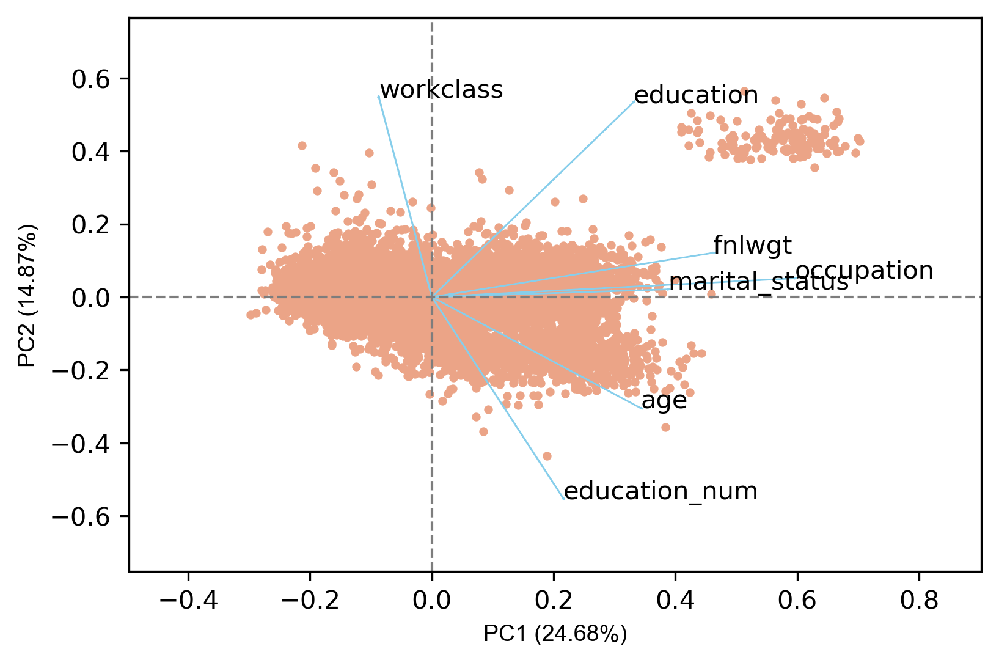

In [10]:
stdsc = StandardScaler()

df2=df1
df2[numerical_columns] = stdsc.fit_transform(df2[numerical_columns].values)

# get PC scores
pca_scores = PCA().fit_transform(df2[numerical_columns])

loadings = pca_out.components_

# get 2D biplot
cluster.biplot(cscore=pca_scores, loadings=loadings, labels=df.columns.values, var1=round(pca_out.explained_variance_ratio_[0]*100, 2),
    var2=round(pca_out.explained_variance_ratio_[1]*100, 2))
    
# get 3D biplot
g = cluster.biplot(cscore=pca_scores, loadings=loadings, labels=df2.columns.values, 
    var1=round(pca_out.explained_variance_ratio_[0]*100, 2), var2=round(pca_out.explained_variance_ratio_[1]*100, 2), 
    var3=round(pca_out.explained_variance_ratio_[2]*100, 2))


Image(filename='biplot_2d.png') 

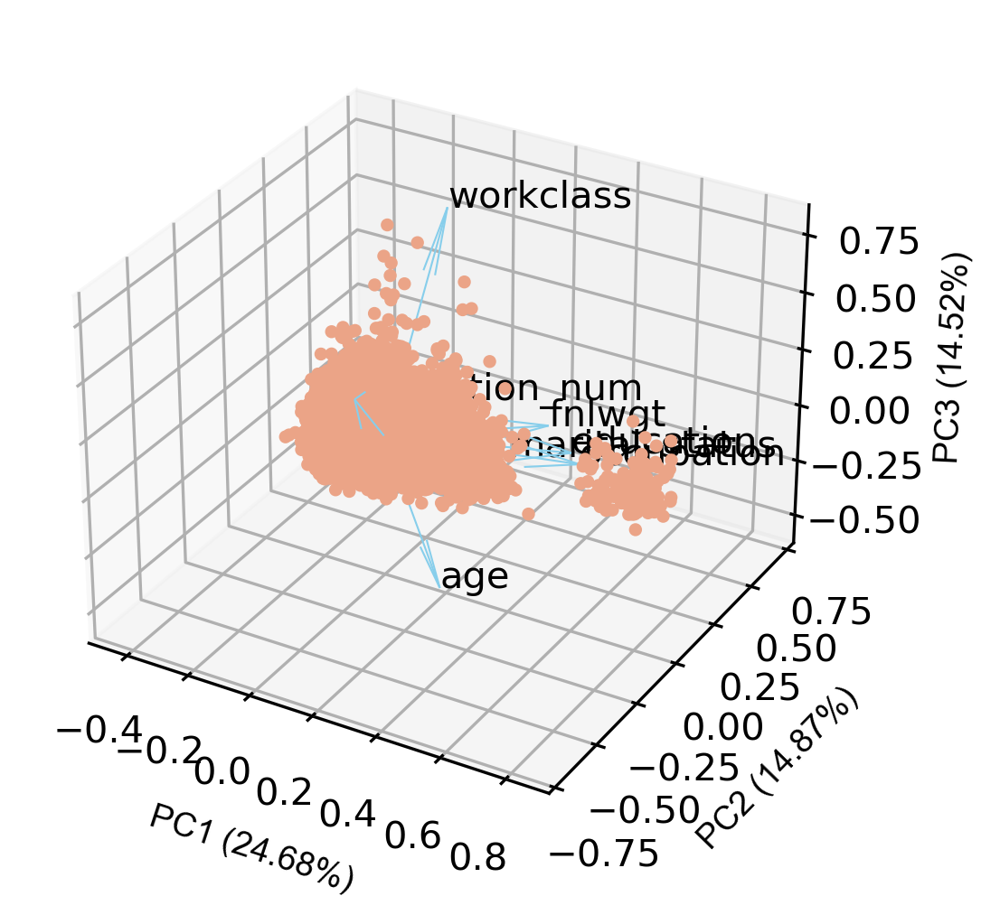

In [13]:
Image(filename='biplot_3d.png') 